# Urgency analysis

In [1]:
from email_utils import *
import pandas as pd
from sklearn.preprocessing import MaxAbsScaler
from sklearn.model_selection import train_test_split
from sklearn import svm
from sklearn.ensemble import RandomForestClassifier
from pipeline_utils import *
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.calibration import CalibratedClassifierCV
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import SelectKBest, f_classif
import eli5
pd.set_option('display.max_rows', 1500)

rc = {'axes.facecolor':'white',
      'axes.edgecolor': 'white',
      'axes.grid' : True,
      'grid.color': '.7',
      'font.family':'Helvetica',
      'font.size' : 20,
      'xtick.major.width': 0,
      'ytick.major.width': 0,
      'figure.dpi': 300}
plt.rcParams.update(rc)

2021-08-23 19:13:57 INFO: Writing properties to tmp file: corenlp_server-92ec60049c9549fe.props


## Read the labeled dataset

Read in the labeled dataset.

In [2]:
df = pd.read_pickle('../data/learning/coded_df.pkl')
df_labels = pd.read_pickle('../data/learning/coded_labels.pkl')
label_column = 'urgency'

df = pd.concat([df, df_labels[label_column].reset_index(drop=True)], axis=1)

In [3]:
df[label_column].value_counts()

False    2423
True      251
Name: urgency, dtype: int64

In [4]:
df.columns

Index(['name', 'subject', 'subject_decoded', 'from_name', 'from_address',
       'from_name_decoded', 'party_affiliation', 'source', 'office_level',
       'incumbent', 'input', 'input_decoded', 'input_decoded_ngram',
       'from_name_decoded_entities_replaced_lowercase',
       'from_name_decoded_entities_preserved_lowercase',
       'subject_decoded_entities_replaced_lowercase',
       'subject_decoded_entities_preserved_lowercase',
       'from_name_decoded_ngram_tags',
       'from_name_decoded_ngram_tags_stopwords', 'subject_decoded_ngram_tags',
       'subject_decoded_ngram_tags_stopwords', 'input_decoded_ngram_tags',
       'input_decoded_ngram_tags_stopwords',
       'from_name_decoded_ngram_tags_original',
       'from_name_decoded_ngram_tags_stopwords_original',
       'subject_decoded_ngram_tags_original',
       'subject_decoded_ngram_tags_stopwords_original',
       'input_decoded_ngram_tags_original',
       'input_decoded_ngram_tags_stopwords_original',
       'from_nam

In [5]:
len(df)

2674

## Split the data

Split the data into train and calibration sets.

In [6]:
labels = df[label_column]

In [7]:
xTrain, xVal, yTrain, yVal = train_test_split(df, labels, test_size=0.20, stratify=labels, random_state=random_state)

In [8]:
len(xTrain), len(yTrain)

(2139, 2139)

In [9]:
len(xVal), len(yVal)

(535, 535)

## Features

Feature pipeline

In [10]:
def get_feature_pipeline():
    return Pipeline([('features', FeatureUnion([
        ('ngram_tags_stopwords', Pipeline([
                ('column_selector', ColumnSelector(column='input_decoded_ngram_tags_stopwords')),
                ('features', TfidfVectorizer(tokenizer=lambda x: x, lowercase=False, use_idf=False, min_df=2)),
        ])),
        ('ngram_tags_org', Pipeline([
                ('column_selector', ColumnSelector(column='input_decoded_ngram_tags_stopwords_original')),
                ('features', TfidfVectorizer(tokenizer=lambda x: x, lowercase=False, use_idf=False, min_df=2)),
        ])),
        ('decoded_prop', Pipeline([
            ('features', DataSelector(column_list=['input_decoded_stop_words_prop',
                                                   'input_decoded_digits_prop',
                                                   'input_decoded_upper_prop',
                                                   'input_decoded_lower_prop']))
        ])),
        ('counts', Pipeline([
            ('features', DataSelector(column_list=['punct_count',
                                                   'count_common_urgency',
                                                   'from_name_decoded_word_count',
                                                   'subject_decoded_word_count',
                                                   'subject_raw_length',
                                                   'from_name_raw_length',
                                                   'subject_unicode_count',
                                                   'from_name_unicode_count',
                                                   'average_word_length'])),
            ('scale', MaxAbsScaler()),
        ])),
    ])),
                     ('select', SelectKBest(f_classif)),
                    ])

def get_feature_names(classifier):
    features = []
    for transformer in classifier.named_steps['feature_pipeline'].named_steps['features'].transformer_list:
        features.extend(transformer[1].named_steps['features'].get_feature_names())

    return features

## Support Vector Classifier

Randomized search using 5-fold cross validation

In [11]:
param_grid = {'classifier__C': [0.01, 0.1, 1.0, 10, 100],
              'classifier__kernel': ['rbf', 'linear'],
              'feature_pipeline__select__k': [500],
              'feature_pipeline__features__ngram_tags_stopwords__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0],
              'feature_pipeline__features__ngram_tags_org__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0]}
            
svc_pipe = Pipeline([('feature_pipeline', get_feature_pipeline()),
                     ('classifier', svm.SVC(class_weight='balanced', probability=True, random_state=random_state))])

svc_clf = GridSearchCV(svc_pipe, param_grid, n_jobs=-1, cv=5, verbose=5, scoring='f1')

svc_results = nested_cross_validation(svc_clf, xTrain, yTrain)

Fitting 5 folds for each of 360 candidates, totalling 1800 fits


2021-08-23 19:14:15 INFO: Writing properties to tmp file: corenlp_server-d7557acd36ad44e1.props
2021-08-23 19:14:15 INFO: Writing properties to tmp file: corenlp_server-f192d6ec129947fc.props
2021-08-23 19:14:15 INFO: Writing properties to tmp file: corenlp_server-8fa31f6681b3477f.props
2021-08-23 19:14:15 INFO: Writing properties to tmp file: corenlp_server-67c6f390e18d4be9.props
2021-08-23 19:14:15 INFO: Writing properties to tmp file: corenlp_server-6627a79234ef4e33.props
2021-08-23 19:14:15 INFO: Writing properties to tmp file: corenlp_server-e0c6218720de48e4.props
2021-08-23 19:14:15 INFO: Writing properties to tmp file: corenlp_server-cb9c89eb9a484a7b.props
2021-08-23 19:14:15 INFO: Writing properties to tmp file: corenlp_server-f23aa3f5f8eb496c.props
2021-08-23 19:14:15 INFO: Writing properties to tmp file: corenlp_server-0c27452afad84549.props
2021-08-23 19:14:15 INFO: Writing properties to tmp file: corenlp_server-d7b932c6da9d4a97.props
2021-08-23 19:14:15 INFO: Writing proper

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.468 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.419 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.435 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline_

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.569 total time=   0.2s[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.414 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.383 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline_

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.346 total time=   0.2s[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.381 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.414 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.534 total time=   0.2s[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.364 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.419 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.391 total time=   0.2s[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.273 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.428 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipelin

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.563 total time=   0.2s[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.396 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.362 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.577 total time=   0.2s[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.439 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.380 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__s

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.549 total time=   0.2s[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.383 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.294 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.547 total time=   0.2s[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.448 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.444 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.639 total time=   0.3s[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.463 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.441 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.4s[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.357 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.444 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.423 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.348 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipel

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.538 total time=   0.3s[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.397 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.408 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.643 total time=   0.5s[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.459 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.414 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeli

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.453 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.495 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__sel

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.482 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.509 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.492 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.540 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.454 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__s

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.561 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.519 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.655 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.610 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pip

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.524 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.518 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.825 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.394 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.593 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__se

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.615 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_p

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pip

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.423 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.604 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.548 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipe

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.567 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.558 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipel

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.545 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipe

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.635 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.440 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pip

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.545 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.457 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.712 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipelin

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.623 total time=   0.2sFitting 5 folds for each of 360 candidates, totalling 1800 fits

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.485 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   0.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipelin

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.647 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.623 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pip

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipel

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.554 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeli

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.491 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pi

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.596 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipe

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.449 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.453 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline_

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=50

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.613 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__sel

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.549 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.576 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.690 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__se

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__selec

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.613 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__se

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.480 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.635 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline_

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.362 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipelin

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.470 total time=   0.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.635 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.456 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.483 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.645 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__se

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.166 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.604 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.508 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipe

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.380 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__s

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.655 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pi

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.000 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.793 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_p

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.240 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.615 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipe

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__sel

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.426 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.588 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__selec

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.166 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.252 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.435 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipe

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.532 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pi

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.409 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.424 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.427 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.403 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.379 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.716 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.000 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.387 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.420 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__s

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.395 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.000 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pi

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.618 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.166 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.000 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pi

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.366 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.000 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pip

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.397 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipelin

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.587 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.483 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.545 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.541 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.166 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.166 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.463 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.463 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__se

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.240 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeli

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.435 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.392 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.424 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.577 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__sel

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.565 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.557 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__sel

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.467 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.596 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.825 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipelin

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.596 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.426 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.650 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.646 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.696 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__s

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.688 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.418 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.632 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.648 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.650 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.438 total time=   0.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.2sFitting 5 folds for each of 360 candidates, totalling 1800 fits

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.514 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.615 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.581 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.479 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__sele

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pi

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.644 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipelin

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.511 total time=   0.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pi

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.597 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_p

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.830 total time=   0.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeli

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.536 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipe

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.654 total time=   0.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipel

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.390 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.627 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeli

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.529 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__selec

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.596 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.523 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__sel

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.403 total time=   0.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeli

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.373 total time=   0.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.690 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__s

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.436 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.588 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__selec

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.385 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.486 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeli

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.348 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.596 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.581 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.679 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, featur

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.427 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.808 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipelin

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.547 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__s

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.571 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.463 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.350 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.614 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.000 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.588 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.352 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.441 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, featur

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.468 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.369 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline_

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.514 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipelin

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.524 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.000 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.357 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__s

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.554 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.000 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_p

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.000 total time=   0.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.709 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.315 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipelin

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.542 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.411 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.516 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.504 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.684 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.061 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipe

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.349 total time=   0.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.000 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.391 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipel

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.525 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipelin

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.357 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.483 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.692 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.590 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeli

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.420 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.407 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__s

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.581 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.689 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipelin

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.648 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.655 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipelin

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.576 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.590 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select_

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.441 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.571 total time=   0.1sFitting 5 folds for each of 360 candidates, totalling 1800 fits

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.701 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.590 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__sel

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.588 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.552 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__selec

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.645 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.431 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.478 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.588 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.596 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.514 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__sel

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.535 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.629 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.556 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.586 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__selec

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.612 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__s

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.690 total time=   0.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.620 total time=   0.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.679 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__se

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.647 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.444 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.618 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline_

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.647 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.635 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipel

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.571 total time=   0.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.613 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__sele

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.589 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.522 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.594 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.592 total time=   0.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline_

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.417 total time=   0.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.807 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.478 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__sele

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.560 total time=   0.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.517 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.415 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipel

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.162 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipelin

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.000 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.680 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_p

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.273 total time=   0.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.327 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.455 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipelin

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.000 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.554 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__se

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.000 total time=   0.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.520 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.642 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pi

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.457 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipelin

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.390 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.457 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.162 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipel

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.569 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.587 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.162 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, featur

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.462 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.413 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   0.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.162 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.000 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pip

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.689 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.000 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.000 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.300 total time=   0.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.482 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.528 total time=   0.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.162 total time=   0.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.250 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pip

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.595 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pi

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.659 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.867 total time=   0.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.593 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipelin

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.529 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.577 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.532 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.678 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline_

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.678 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.000 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_p

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.683 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.519 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.533 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.400 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.509 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.491 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.605 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.563 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__s

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.540 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipe

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.687 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.676 total time=   0.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeli

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.620 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.881 total time=   0.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   0.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.585 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.588 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipel

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.576 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.576 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.592 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select_

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.825 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__se

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.367 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeli

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipe

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.543 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.630 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select_

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipel

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.373 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.889 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeli

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.609 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   0.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.580 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.552 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.542 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.515 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__selec

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.609 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select_

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.426 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.375 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipe

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__s

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.514 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.385 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.441 total time=   0.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__se

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.487 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.385 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.373 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.585 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__s

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.526 total time=   0.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline_

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.398 total time=   0.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.644 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipel

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.612 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeli

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.395 total time=   0.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.583 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__sele

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.000 total time=   0.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.059 total time=   0.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.411 total time=   0.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.392 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeli

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.793 total time=   0.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.600 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.000 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.363 total time=   0.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.365 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__se

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.365 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.417 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline_

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.459 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.574 total time=   0.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.620 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.496 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.333 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.529 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipelin

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.361 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.349 total time=   0.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__selec

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.171 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.344 total time=   0.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.345 total time=   0.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_p

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.463 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.496 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.440 total time=   0.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__sel

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.648 total time=   0.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.420 total time=   0.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.480 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.485 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.383 total time=   0.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.526 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__se

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.000 total time=   0.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.659 total time=   0.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.387 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.441 total time=   0.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline_

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.059 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.435 total time=   0.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.534 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.598 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__se

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pi

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.545 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.603 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.577 total time=   0.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_p

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.333 total time=   0.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.632 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.549 total time=   0.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.692 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeli

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.171 total time=   0.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.171 total time=   0.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.641 total time=   0.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   0.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipe

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.476 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.541 total time=   0.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline_

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.707 total time=   0.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   0.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pip

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.571 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.615 total time=   0.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.632 total time=   0.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipel

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pip

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.467 total time=   0.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.609 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.458 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, featu

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.690 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.711 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__selec

In [12]:
for i, sr in enumerate(svc_results):
    print('Fold ', i)
    print('F1 score ', sr[0])
    print('Params ', sr[2])
    print('\n')

Fold  0
F1 score  0.8717948717948718
Params  {'classifier__C': 1.0, 'classifier__kernel': 'linear', 'feature_pipeline__features__ngram_tags_org__features__max_df': 0.1, 'feature_pipeline__features__ngram_tags_stopwords__features__max_df': 1.0, 'feature_pipeline__select__k': 500}


Fold  1
F1 score  0.8809523809523809
Params  {'classifier__C': 10, 'classifier__kernel': 'linear', 'feature_pipeline__features__ngram_tags_org__features__max_df': 0.1, 'feature_pipeline__features__ngram_tags_stopwords__features__max_df': 1.0, 'feature_pipeline__select__k': 500}


Fold  2
F1 score  0.761904761904762
Params  {'classifier__C': 1.0, 'classifier__kernel': 'linear', 'feature_pipeline__features__ngram_tags_org__features__max_df': 0.1, 'feature_pipeline__features__ngram_tags_stopwords__features__max_df': 1.0, 'feature_pipeline__select__k': 500}


Fold  3
F1 score  0.8571428571428572
Params  {'classifier__C': 10, 'classifier__kernel': 'linear', 'feature_pipeline__features__ngram_tags_org__features__ma

In [13]:
np.mean(list(map(lambda x: x[0], svc_results)))

0.8393589743589743

In [14]:
features_all = get_feature_names(svc_results[1][1])
features_mask = svc_results[1][1].named_steps['feature_pipeline'].named_steps['select'].get_support()
features_svc = [b for a, b in zip(features_mask, features_all) if a]

In [15]:
eli5.explain_weights(svc_results[1][1].named_steps['classifier'], top=100, feature_names=features_svc)

Weight?,Feature
+8.289,can you help
+6.228,time be
+5.943,before
+5.806,urgent
+4.422,asap
+4.231,final
+4.075,deadline
+4.000,asap
+3.833,deadline
+3.766,tokennorp majority tokenperson


## Random forest

Randomized search using 5-fold cross validation

In [16]:
n_estimators = [10, 20, 50, 70, 100]
max_depth = [10, 30, 50, 70, 90, 100]
max_depth.append(None)
max_features = ['auto', 'sqrt', 'log2']
min_samples_split = [2, 5, 10, 15, 20]
min_samples_leaf = [1, 2, 4, 6, 8, 10]
bootstrap = [True, False]
criterion = ['gini', 'entropy']

param_grid = {'classifier__n_estimators': n_estimators,
              'classifier__max_features': max_features,
              'classifier__max_depth': max_depth,
              'classifier__min_samples_split': min_samples_split,
              'classifier__min_samples_leaf': min_samples_leaf,
              'classifier__bootstrap': bootstrap,
              'classifier__criterion': criterion,
              'feature_pipeline__select__k': [500],
              'feature_pipeline__features__ngram_tags_stopwords__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0],
              'feature_pipeline__features__ngram_tags_org__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0]}

rf_pipe = Pipeline([('feature_pipeline', get_feature_pipeline()),
                    ('classifier', RandomForestClassifier(class_weight='balanced', random_state=random_state))])

rf_clf = RandomizedSearchCV(rf_pipe, param_grid, n_jobs=-1, cv=5, n_iter=2000, verbose=5, scoring='f1', random_state=random_state)
rf_results = nested_cross_validation(rf_clf, xTrain, yTrain)

Fitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipelin

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.484 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.711 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__s

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.656 total time=   0.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.536 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select_

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.918 total time=   0.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.870 total time=   0.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeli

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipe

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.623 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipel

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipe

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.825 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeli

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline_

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.581 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select_

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   0.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.646 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__sele

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.679 total time=   0.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__selec

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.576 total time=   0.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   0.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kerne

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.657 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.436 total time=   0.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.481 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__kerne

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.563 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kerne

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.698 total time=   0.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.548 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kern

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.578 total time=   0.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__C=10, classifier__kerne

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.656 total time=   0.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.689 total time=   0.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.609 total time=   0.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.545 total time=   0.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.679 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.685 total time=   0.2s
[CV 3/5] END classifier__C=100, classifier__kern

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.679 total time=   0.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=lin

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.286 total time=   0.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__k

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   0.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.519 total time=   0.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.536 total time=   0.4s
[CV 2/5] END classifier__C=100, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.465 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.625 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.793 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.615 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.655 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__feat

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, c

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.553 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.642 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.382 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.472 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifie

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.658 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.453 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.537 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifie

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.636 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.578 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sam

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.678 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.656 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.714 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.520 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.462 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.685 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.793 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.510 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.575 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.814 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.303 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.634 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.871 total time=   0.4s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.648 total time=   0.4s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.321 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.538 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.621 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.649 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.462 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.488 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifie

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.507 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.629 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.577 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.400 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.639 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.704 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.643 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   0.5s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.219 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.385 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.686 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.610 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.828 total time=   0.4s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.4s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.300 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.421 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.112 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sam

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.703 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sample

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.355 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.171 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.581 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.340 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.700 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.600 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.807 total time=   0.4s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.679 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.568 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.179 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.323 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.567 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.692 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.483 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.675 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.563 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.628 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.649 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.633 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sa

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.577 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.648 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.186 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.509 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.444 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.658 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.694 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.581 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.472 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.375 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.607 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.630 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.117 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.447 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.649 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.481 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.471 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.685 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.588 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.620 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sam

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.244 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.468 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.186 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.471 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.553 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.340 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.686 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.507 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.629 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.675 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.606 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samp

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.585 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.675 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.545 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.400 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.492 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.684 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.281 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.646 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.492 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.113 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.644 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.459 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.685 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.333 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.444 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.630 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.530 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.701 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.685 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.386 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.602 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.623 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.629 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.700 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.132 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.475 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.525 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.548 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.571 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.593 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.433 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sampl

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.522 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.559 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.203 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.392 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.557 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.717 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.261 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.692 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.575 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.818 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.515 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.493 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.456 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.478 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.648 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.553 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.569 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.629 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.239 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.567 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.689 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.685 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.646 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.690 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.515 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.630 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.564 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.133 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.542 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.647 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.693 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.163 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.684 total time=   0.4s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.694 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samp

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.701 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.231 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.677 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.687 total time=   0.4s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.644 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sam

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.516 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.583 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.545 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.4s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.541 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sam

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.618 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.649 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.540 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sa

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.686 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.336 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.522 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.692 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.648 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.552 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.585 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.606 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.308 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.625 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.576 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samp

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.257 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.595 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.639 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.414 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.532 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.689 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.649 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.258 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.433 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.683 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.588 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.629 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.711 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.521 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.444 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.261 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.619 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.566 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.391 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.587 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.583 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.286 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.647 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samp

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.520 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.646 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_sample

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.576 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samp

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.328 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.532 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.348 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.508 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.431 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifie

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.657 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.095 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.684 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samp

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.538 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.642 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.564 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sample

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.525 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.629 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.605 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samp

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.686 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samp

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.633 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.521 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.698 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.656 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.542 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.514 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.390 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.645 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.629 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.557 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.591 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sa

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.603 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.692 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.511 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.620 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   0.4s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.462 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.590 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.286 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.509 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   0.4s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.679 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifie

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.825 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.4s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.4s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sam

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.581 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.639 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.383 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.326 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.349 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.693 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.561 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.609 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.386 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.645 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.611 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.543 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.684 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.338 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samp

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.623 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.610 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   0.4s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.494 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.686 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.484 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.545 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.468 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sam

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.208 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.699 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.545 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.400 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.596 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.491 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.585 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.179 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.448 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.590 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.700 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.625 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.548 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.441 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.611 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.105 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.444 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.597 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.549 total time=   0.5s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.357 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.421 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classif

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.597 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.684 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.463 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samp

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.490 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.500 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.455 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.374 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.343 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sam

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.615 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.517 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.533 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.449 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.611 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifie

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.547 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samp

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.476 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.652 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.531 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.612 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samp

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.216 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.579 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.507 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.333 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.240 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.633 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.404 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.692 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.321 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sa

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.407 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.693 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.717 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.455 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.606 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.346 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.618 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.216 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.170 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.622 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.689 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sample

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.371 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.618 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samp

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.134 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.717 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samp

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.383 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.581 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.602 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.225 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.279 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.571 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.475 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.622 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifie

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.456 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.692 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifie

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.171 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.611 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.489 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.741 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.576 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.381 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.563 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.675 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.538 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sam

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.615 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sam

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.326 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sample

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.522 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.620 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.554 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.615 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.629 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.542 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.484 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.623 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.709 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.576 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.579 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.510 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifie

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.567 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.644 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.462 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.871 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.195 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.554 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.483 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.615 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.423 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.532 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.603 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.481 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.188 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.622 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_sample

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.260 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.658 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.613 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.440 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.633 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sam

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.701 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.618 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.594 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.456 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.367 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.634 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.515 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.658 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.464 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.635 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.1sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifie

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.538 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.650 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sampl

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.212 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.466 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.618 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.618 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.114 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.701 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.629 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.441 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.595 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.771 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sam

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.514 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.640 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.646 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.675 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.493 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samp

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.650 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.655 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.714 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.559 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.633 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.641 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.684 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.696 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.597 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.638 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.693 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.830 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.505 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.381 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.697 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.525 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.238 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samp

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.471 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.492 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.561 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.474 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.644 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.632 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sam

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.233 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.345 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.686 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.429 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.700 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.646 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.491 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.393 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.900 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.629 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.702 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.609 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.586 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.294 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.658 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.645 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.590 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.395 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samp

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.566 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.687 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.548 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.460 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samp

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.148 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.648 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.390 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.582 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.533 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.615 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.451 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sa

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.242 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.537 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.219 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classif

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.645 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.678 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.647 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__m

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.400 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.648 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.495 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.567 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.226 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.658 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.171 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.426 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.581 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.642 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.280 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.552 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.577 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sample

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samp

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.633 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.119 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.345 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.588 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classif

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.638 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.575 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.222 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.582 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.288 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.622 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.677 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.714 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.432 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.582 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.645 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_l

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.633 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.386 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.267 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.658 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.640 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.590 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.658 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sam

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.367 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.627 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.545 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.362 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.464 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.605 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.506 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.793 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.494 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifie

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.649 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.204 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.566 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.814 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.535 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.658 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.588 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.495 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.594 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sam

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.182 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.400 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.475 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.515 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.581 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.693 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samp

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.709 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sample

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.635 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.529 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.307 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sample

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.609 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_sam

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.646 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.525 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.633 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.533 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.588 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.597 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.475 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.153 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__m

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.514 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.168 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.636 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.533 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.646 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.689 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.618 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sample

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.566 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.581 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.613 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.244 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.675 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.677 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.557 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.590 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.587 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.364 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.417 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.646 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.406 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.581 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.328 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.635 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sam

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.615 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.596 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.620 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.424 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.184 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.311 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_s

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.703 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.593 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.267 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.535 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samp

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.368 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.889 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sample

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.490 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.542 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.689 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.658 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.647 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.648 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.689 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.675 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sam

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.685 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sampl

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.686 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.441 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.700 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.678 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.538 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.609 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.635 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sam

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.520 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.438 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.679 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.564 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.465 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.641 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.638 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.361 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.597 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.463 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.690 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.261 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.400 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifie

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.594 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.441 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sam

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.346 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.467 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.633 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.595 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.356 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.211 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.478 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.535 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.532 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sa

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.282 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.505 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.684 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.582 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.521 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.696 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.632 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.455 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.460 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.693 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.646 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.697 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.658 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.433 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.553 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.560 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__m

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.526 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.486 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.516 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.484 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.180 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.494 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samp

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.581 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.171 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.635 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.299 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.615 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sample

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.696 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.426 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.553 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.694 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sample

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.686 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sampl

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.636 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.620 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.685 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.469 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.581 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.615 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.587 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifie

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.692 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.611 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.333 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.606 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.480 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.557 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.642 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samp

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.617 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.613 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sample

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.633 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samp

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.675 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.406 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sample

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.507 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.622 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sam

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.414 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.162 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.693 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.630 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sampl

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.448 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.606 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.877 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.486 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.581 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sam

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.615 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.630 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.154 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.464 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.048 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sam

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.508 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.524 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.171 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.643 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.394 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.493 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.567 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.531 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.551 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.685 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.867 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.643 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.238 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.659 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.686 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.407 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.317 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.633 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.597 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.567 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.439 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.623 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.419 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.643 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.684 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.689 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifie

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.658 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sample

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.674 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.279 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.557 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.595 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.311 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.459 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifie

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.640 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.122 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.615 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.203 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classif

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.406 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.889 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.078 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.411 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.161 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.299 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sample

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.590 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.679 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.540 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.494 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.537 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.533 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.419 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.480 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.622 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.330 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.413 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.610 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.613 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.731 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.639 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samp

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.464 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.632 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.464 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.540 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.564 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.480 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.636 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.525 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.793 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samp

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.607 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.593 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.367 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.630 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.467 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.548 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.491 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.625 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sam

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.460 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.510 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.597 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.651 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.154 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.492 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.061 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.610 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sam

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.238 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.649 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.636 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.480 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.516 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.693 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.629 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.686 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.675 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.444 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.617 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.636 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.606 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.394 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.406 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.639 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.561 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sampl

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.645 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.507 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.696 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sam

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.554 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.308 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.536 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.639 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.582 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.675 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samp

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.648 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.644 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sample

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.526 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.244 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.478 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.658 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.716 total time=   0.1sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.629 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sam

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.523 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.540 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sam

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.478 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.432 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.585 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.644 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.308 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.508 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.646 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.554 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.642 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.648 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.528 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.537 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.638 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.621 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.559 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.478 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.692 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.576 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.557 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.684 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sam

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.640 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.511 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.557 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.323 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.553 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.487 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samp

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.793 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.344 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.382 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.531 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.556 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.606 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.644 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_s

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.636 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samp

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.605 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifie

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.388 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.638 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.554 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.531 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.566 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.697 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.345 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.202 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.286 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.559 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samp

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.648 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.658 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.340 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sample

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.571 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.686 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.655 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.232 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.584 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.627 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_sam

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.417 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.324 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifie

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.686 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.393 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_sam

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.286 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.658 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.615 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.420 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.405 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_s

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.647 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.684 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.731 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.583 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.828 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__m

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.825 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.646 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.269 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.455 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.684 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.627 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sam

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.473 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.450 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sample

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.508 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.567 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.531 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.686 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.703 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.523 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.692 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samp

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.581 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.567 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.623 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.333 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.600 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sample

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_s

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.622 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.548 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.188 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.561 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.627 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.684 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.655 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.623 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.542 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sampl

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.197 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.615 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.606 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.636 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sam

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.373 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.554 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.333 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.232 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samp

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.654 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.548 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.525 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sample

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.481 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.436 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.620 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.548 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.609 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.469 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.620 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.644 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.247 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.477 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.429 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.606 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.523 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.348 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.346 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.531 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.440 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.566 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.640 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.655 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samp

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifie

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.209 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.535 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samp

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifie

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.870 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sam

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.875 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.491 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.429 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.523 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sam

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.575 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.551 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.420 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.483 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samp

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.606 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.465 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.693 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sam

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.427 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.236 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.388 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.325 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.406 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samp

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.308 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.703 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.444 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samp

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.459 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.382 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classif

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samp

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.649 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.648 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.684 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.427 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.585 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.484 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.608 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samp

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sample

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.319 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.586 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifie

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.431 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.615 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.889 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_sample

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.543 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.275 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.595 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.538 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.330 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.647 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.528 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.655 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.703 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.535 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.627 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.647 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.530 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.609 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.632 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.593 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.510 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.325 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.561 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samp

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.645 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.709 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.449 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samp

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.575 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.650 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifie

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.587 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.462 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.563 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.582 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.519 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.368 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sample

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.678 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.615 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sam

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.612 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.684 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.602 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.538 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sample

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.635 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.526 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sam

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.313 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.533 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.245 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.600 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__m

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.553 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samp

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.814 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samp

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.853 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sam

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.333 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.553 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.597 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.627 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.646 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.632 total time=   0.4s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.273 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.597 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.584 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sam

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.200 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.523 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.269 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.686 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.821 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sampl

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.706 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.701 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.848 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.680 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.657 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.387 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sam

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.610 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.171 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.871 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.597 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.684 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.578 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.646 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.708 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.296 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.604 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sam

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.560 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classif

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.515 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.171 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sample

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_s

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.639 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.685 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samp

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.435 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.692 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.373 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.473 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.407 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.492 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.679 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.485 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.327 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.622 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.675 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.687 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sampl

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.259 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.621 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifie

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.407 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samp

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.561 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.291 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.613 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.171 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.603 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.561 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.563 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sampl

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.366 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.655 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.400 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.455 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.189 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.603 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.528 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.484 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.623 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.613 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.627 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.551 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.407 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.600 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.507 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.649 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.485 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samp

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.632 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.295 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sam

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.542 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.216 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sample

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.296 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.286 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.478 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.533 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.611 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.692 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.247 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sam

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.566 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.684 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.793 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.613 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.510 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.400 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.684 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.613 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.566 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.386 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.548 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.302 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.505 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.436 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classif

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.686 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.644 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.263 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sa

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.535 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.566 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.625 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.581 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.648 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.452 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.302 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.703 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.687 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.647 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.390 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sample

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.641 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.526 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samp

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.538 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.630 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.678 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.448 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__m

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.571 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.187 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.514 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.305 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__m

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.627 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.562 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.630 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.675 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.438 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.607 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifie

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.814 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sampl

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.346 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sam

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.646 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sampl

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.459 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.586 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.481 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.245 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classif

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.842 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.692 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.566 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.505 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.615 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.651 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.581 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.632 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.456 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.529 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.344 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.548 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.658 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sample

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.342 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.366 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.178 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.593 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.493 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.297 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.468 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.693 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sa

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.658 total time=   0.2sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.400 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, 

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.650 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.180 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sampl

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.515 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.379 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.571 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__m

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifie

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.526 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.491 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.293 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.636 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.597 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.436 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_s

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.620 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sample

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.556 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.370 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.575 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samp

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sample

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.635 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.603 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.324 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.378 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.400 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.689 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classif

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.444 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.485 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.807 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.388 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sampl

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.578 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.686 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.360 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.646 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.623 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.366 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.567 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.866 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.885 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.915 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.896 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.256 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_s

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.597 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.528 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.407 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.180 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.689 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.648 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.641 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.618 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samp

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.388 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.378 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.685 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.525 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.551 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.609 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.632 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.615 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.900 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.655 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.194 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.262 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.433 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.353 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifie

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.577 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.921 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.646 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.643 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.567 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.556 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sample

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samp

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.593 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sample

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.444 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.542 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, class

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.375 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.600 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.536 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.640 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.554 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__m

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.585 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.431 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sam

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.636 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sampl

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.528 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.491 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.881 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.935 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.610 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.687 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.557 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.378 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samp

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.554 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.642 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.692 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.693 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.444 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samp

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sam

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.583 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.349 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.314 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.636 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.682 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.620 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.252 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.693 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.877 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.585 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sam

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.613 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.657 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifie

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.240 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.419 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.650 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifie

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.636 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.472 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.684 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.644 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.444 total time=   0.4s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.867 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.467 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.647 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.516 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.654 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.644 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.393 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sample

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.646 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.201 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.875 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.635 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.677 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifie

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.636 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.507 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.489 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.394 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, clas

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.627 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.657 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.216 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.635 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.590 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sampl

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.620 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samp

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.617 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.449 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.286 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.693 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.647 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.632 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.257 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.370 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.392 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.568 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.938 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.486 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.596 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.431 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.590 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.658 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.900 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.675 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.686 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.351 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.533 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.583 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.375 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.317 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.897 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.627 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sample

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.576 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.224 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.627 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.848 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.610 total time=   0.4s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.543 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.575 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.588 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.606 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.593 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.481 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.686 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.683 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.588 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.417 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samp

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.559 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samp

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.866 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.923 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifie

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.630 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.933 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifie

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.538 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.486 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.429 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.505 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.576 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.301 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.444 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.467 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.915 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.383 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.594 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifie

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.581 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.507 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.590 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sample

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.586 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.048 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.951 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.213 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.409 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.454 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifie

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.414 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.537 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.400 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.549 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.630 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.300 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.697 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.613 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.429 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samp

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.615 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.584 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.256 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.404 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.526 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.120 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.424 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.264 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.829 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.698 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.519 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.190 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.366 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifie

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.304 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.807 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.793 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.273 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.556 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.566 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.879 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.545 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samp

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.515 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.892 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.935 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.393 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.563 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.613 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.492 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.519 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.143 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.542 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.490 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.419 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.613 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.623 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.698 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.703 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.426 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.468 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.567 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.149 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.644 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.536 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.918 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.271 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.875 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.491 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.677 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.455 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sample

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.561 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.571 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.687 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.346 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.409 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.906 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.390 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.416 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.935 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.431 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.206 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.295 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.489 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.610 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.611 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.632 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samp

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.627 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sam

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sam

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.647 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sampl

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samp

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.232 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.545 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.693 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.596 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.593 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.364 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.508 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.448 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sam

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.528 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samp

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.685 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.607 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.210 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.243 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.411 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.639 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.703 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.649 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.629 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sam

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.598 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.427 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.563 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.597 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sam

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifie

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.685 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sa

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.566 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samp

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.618 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.873 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sam

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.439 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.316 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.092 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.618 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_l

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.590 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.206 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.489 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.644 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.282 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.394 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.516 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.213 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.159 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.537 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.533 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.623 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.658 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samp

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.680 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.369 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.387 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.655 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.511 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.504 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.586 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sampl

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.581 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.542 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.538 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.903 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.576 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.449 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.486 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.613 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sampl

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.341 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.528 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.393 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.596 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.225 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.643 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samp

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.580 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.181 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.623 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.680 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samp

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.509 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.638 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.252 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classif

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sample

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.642 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.709 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.630 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.421 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.550 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.633 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samp

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.879 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classif

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.466 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.586 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.635 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.545 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.522 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.423 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.674 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.848 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samp

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.564 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.646 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.645 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifie

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.232 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifie

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.687 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.678 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_sample

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.680 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sample

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.615 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.618 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.881 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.395 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.690 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.647 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.638 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samp

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.643 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.560 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.322 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.567 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samp

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samp

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.600 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.640 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sampl

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.841 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.240 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.605 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.677 total time=   0.2sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.648 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.500 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.516 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.610 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.459 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.606 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.387 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.618 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.603 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.578 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.458 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.906 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.645 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.464 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.678 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.611 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.567 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.628 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.512 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.465 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.639 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.581 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.435 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.885 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.409 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samp

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.552 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.621 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.578 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.468 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.595 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.458 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.283 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.350 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_s

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sample

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.842 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.361 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_s

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.896 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.257 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.580 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.885 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.431 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.556 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.466 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.657 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.647 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sa

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.176 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.900 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.525 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.909 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sample

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.630 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.219 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.526 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.462 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.525 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.627 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.842 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.568 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.400 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.440 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.258 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.424 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.411 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.333 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.630 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.590 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.659 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samp

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.692 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.562 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.177 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.647 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifie

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.533 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.204 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.596 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.308 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__m

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.638 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.215 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.653 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.224 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.384 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.553 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__m

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.551 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.621 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.579 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.478 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.218 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifie

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.539 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.464 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.557 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.579 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.587 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.557 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifie

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.557 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.468 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.429 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.709 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.567 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_s

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.554 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.593 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.571 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.639 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.455 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.415 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.647 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.523 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.675 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.488 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.638 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.533 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.431 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.429 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.457 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.625 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.353 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.259 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.585 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.554 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.444 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.618 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.701 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.648 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.621 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.551 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.627 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.408 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.886 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.429 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.537 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.615 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.400 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.364 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.476 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.444 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.440 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.592 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.689 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.469 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.553 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.176 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.657 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.687 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samp

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.219 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.176 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.586 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samp

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.548 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.618 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifie

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.190 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.327 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.847 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.347 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.113 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.862 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.548 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sam

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.310 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.436 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sam

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.225 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifie

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.432 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_sam

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.585 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.613 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.885 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.925 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.554 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.142 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.533 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.600 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifie

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.542 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.576 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sam

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.407 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.204 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.284 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.173 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.845 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.639 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.623 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.625 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.507 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.679 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.658 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.698 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.472 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.607 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.369 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.416 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.899 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.596 total time=   0.4s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.610 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.552 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.656 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.532 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.557 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.653 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.925 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.232 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.349 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.336 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.648 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samp

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.168 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samp

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.525 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.560 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.408 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.630 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.492 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sam

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.241 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.540 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.508 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.476 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.432 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.383 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.690 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.541 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.609 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.449 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sam

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.241 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.627 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifie

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.571 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.704 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.597 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.825 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.562 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.845 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.441 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sampl

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.312 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.567 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.548 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.200 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.516 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.507 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.531 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.632 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.438 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.551 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.822 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.522 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.257 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.297 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.140 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samp

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.701 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.397 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.615 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sampl

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.612 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.469 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.634 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.605 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.218 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.480 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifie

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.605 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.515 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.696 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.903 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sampl

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.482 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.323 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifie

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.658 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.613 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sampl

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.476 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.594 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.852 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.483 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.875 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.596 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.177 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.500 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__m

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.658 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.701 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.492 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.361 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.638 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__m

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.433 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.586 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__mi

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.882 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.520 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.417 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.649 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.553 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.259 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.613 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.658 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.560 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.400 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.538 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.583 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.608 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.506 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sam

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.370 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_s

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.691 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.495 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.438 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier_

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.625 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.687 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.369 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.630 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.119 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.000 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.586 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classif

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.629 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.364 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.421 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.700 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.413 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_s

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.306 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__mi

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sample

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.400 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samp

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.649 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.613 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.625 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.853 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_sa

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.421 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.557 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.618 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_sa

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.268 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.633 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.550 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.533 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.430 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.333 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__mi

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.630 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.444 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.486 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifie

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.170 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.693 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.432 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.560 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.703 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sample

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.847 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifie

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.857 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.529 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.689 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.381 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.603 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__m

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.698 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.852 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sample

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.462 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.658 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.679 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier_

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.842 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.657 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.829 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.430 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.290 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.879 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.268 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.393 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.633 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.639 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.575 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_sam

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sample

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.554 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.881 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sample

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.395 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.511 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifie

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.254 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.417 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.456 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_sample

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.291 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samp

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_sam

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.561 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.294 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.427 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.647 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.436 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.625 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.658 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.607 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sample

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sam

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.640 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.486 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sa

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.607 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.587 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.833 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_sampl

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.648 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.676 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.234 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.615 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.622 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.545 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.494 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.147 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.467 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier_

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.702 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.400 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sample

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.448 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.862 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.299 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_sampl

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.542 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifie

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.138 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sa

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samp

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   0.3s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.299 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samp

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.603 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifie

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.687 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.717 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.3s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifie

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.571 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sample

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_sa

[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.3s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.847 total time=   0.3s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.687 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.587 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.600 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samp

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.628 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samp

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.320 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.653 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sa

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.492 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.448 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifie

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.3s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_s

[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.646 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.557 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_sa

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.857 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.523 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.358 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__min_s

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.175 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sampl

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.862 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_sa

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__m

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.3s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.636 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_sa

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.632 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.153 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.629 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.597 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.579 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifi

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.609 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.862 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min_s

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.687 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.448 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__mi

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.889 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__mi

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.571 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.455 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.600 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier__m

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier

[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.676 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=log2, classifier__min

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.178 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.650 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sam

[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_

[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.231 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.678 total time=   0.2s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=auto, classifier__min_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.685 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__min_s

[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=log2, classifier_

[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.867 total time=   0.1s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_s

[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.593 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_sam

[CV 2/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=log2, classifier__m

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.541 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samp

[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.593 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samp

In [17]:
for i, rr in enumerate(rf_results):
    print('Fold ', i)
    print('F1 score ', rr[0])
    print('Params ', rr[2])
    print('\n')

Fold  0
F1 score  0.8266666666666665
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__ngram_tags_stopwords__features__max_df': 0.02, 'feature_pipeline__features__ngram_tags_org__features__max_df': 0.005, 'classifier__n_estimators': 70, 'classifier__min_samples_split': 5, 'classifier__min_samples_leaf': 2, 'classifier__max_features': 'sqrt', 'classifier__max_depth': 30, 'classifier__criterion': 'gini', 'classifier__bootstrap': False}


Fold  1
F1 score  0.8205128205128205
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__ngram_tags_stopwords__features__max_df': 0.02, 'feature_pipeline__features__ngram_tags_org__features__max_df': 1.0, 'classifier__n_estimators': 100, 'classifier__min_samples_split': 5, 'classifier__min_samples_leaf': 1, 'classifier__max_features': 'auto', 'classifier__max_depth': 100, 'classifier__criterion': 'entropy', 'classifier__bootstrap': False}


Fold  2
F1 score  0.8
Params  {'feature_pipeline__select__k': 500, 'f

In [18]:
np.mean(list(map(lambda x: x[0], rf_results)))

0.8208084464555052

In [19]:
features_all = get_feature_names(rf_results[3][1])
features_mask = rf_results[3][1].named_steps['feature_pipeline'].named_steps['select'].get_support()
features_rf = [b for a, b in zip(features_mask, features_all) if a]

In [20]:
eli5.explain_weights(rf_results[3][1].named_steps['classifier'], top=100, feature_names=features_rf)

Weight,Feature
0.0863 ± 0.0609,deadline
0.0855 ± 0.0772,urgent
0.0530 ± 0.0639,count_common_urgency
0.0254 ± 0.0590,before
0.0254 ± 0.0546,tokencardinal day
0.0243 ± 0.0491,final
0.0189 ± 0.0412,time
0.0164 ± 0.0271,punct_count
0.0156 ± 0.0387,final
0.0150 ± 0.0445,last chance


## Compute the final performance on the holdout set

In [21]:
svc_results[1][2]

{'classifier__C': 10,
 'classifier__kernel': 'linear',
 'feature_pipeline__features__ngram_tags_org__features__max_df': 0.1,
 'feature_pipeline__features__ngram_tags_stopwords__features__max_df': 1.0,
 'feature_pipeline__select__k': 500}

In [22]:
clf = Pipeline([('feature_pipeline', get_feature_pipeline()),
                ('classifier', svm.SVC(class_weight='balanced', probability=True, random_state=random_state))])

clf.set_params(**svc_results[1][2])
clf.fit(xTrain, yTrain)

Pipeline(steps=[('feature_pipeline',
                 Pipeline(steps=[('features',
                                  FeatureUnion(transformer_list=[('ngram_tags_stopwords',
                                                                  Pipeline(steps=[('column_selector',
                                                                                   ColumnSelector(column='input_decoded_ngram_tags_stopwords')),
                                                                                  ('features',
                                                                                   TfidfVectorizer(lowercase=False,
                                                                                                   min_df=2,
                                                                                                   tokenizer=<function get_feature_pipeline.<locals>.<lambda> at 0x7fa8260eb1f0>,
                                                                                  

In [23]:
holdout = pd.read_pickle('../data/learning/holdout_df.pkl')
holdout_labels = pd.read_pickle('../data/learning/holdout_labels.pkl')

holdout_df = pd.concat([holdout, holdout_labels[label_column].reset_index(drop=True)], axis=1)

Test set output:
1. Classification report:
              precision    recall  f1-score   support

       False       0.99      1.00      0.99       451
        True       0.96      0.88      0.91        49

    accuracy                           0.98       500
   macro avg       0.97      0.94      0.95       500
weighted avg       0.98      0.98      0.98       500



2. Confusion matrix:
     pred_neg  pred_pos
neg       449         2
pos         6        43


4. False positives:
                                 name  \
193  Democratic Conservation Alliance   
223                    Daniel Epstein   

                                               subject  \
193                      RESTORE the Voting Rights Act   
223  You can check wait times before going to the p...   

                                       subject_decoded  \
193                      RESTORE the Voting Rights Act   
223  You can check wait times before going to the p...   

                    from_name          

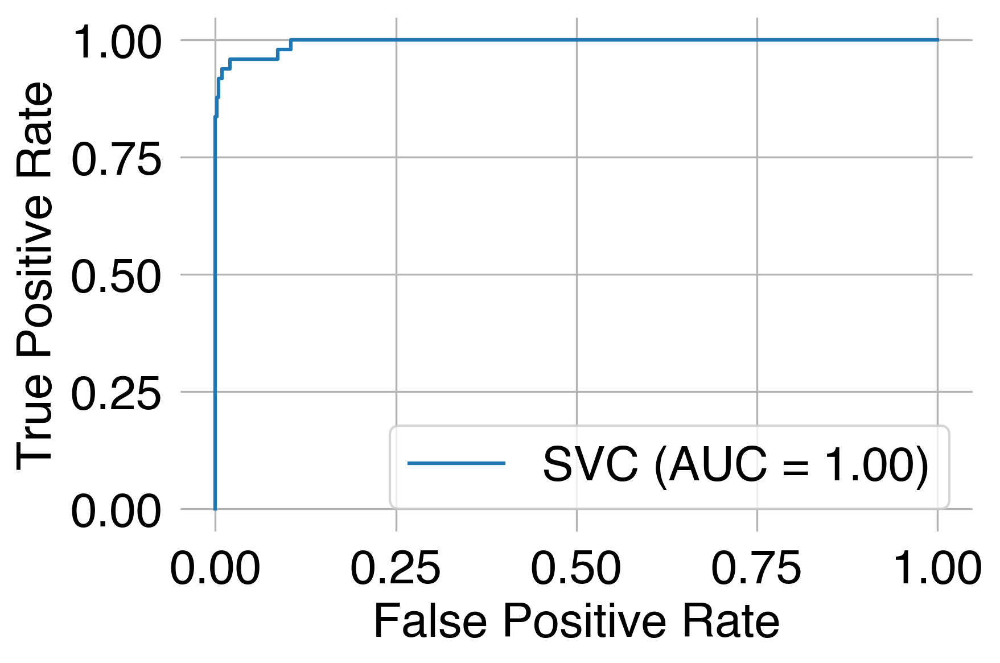

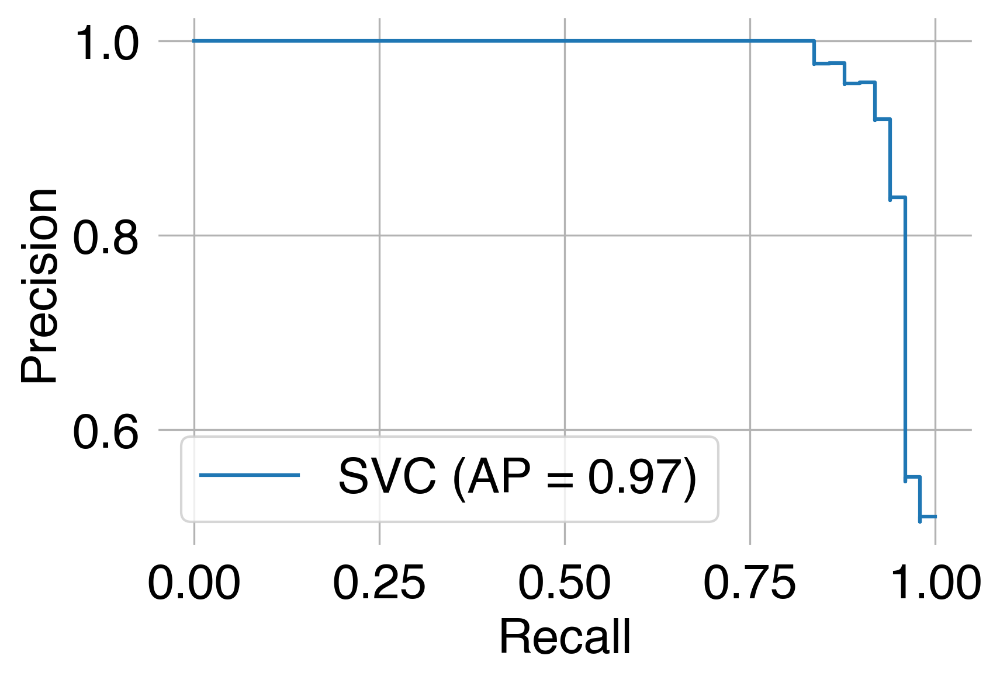

In [24]:
print_classifier_output(clf, holdout_df, holdout_df[label_column], actual_subjects=holdout_df, classifier_name='SVC', filepath='../data/plots/urgency_')

## Calibration test

  category      prop      mean        ll        ul  count
0        1  0.018367  0.018005  0.008675  0.016168  490.0
1        2  0.911111  0.911007  0.118447  0.053778   45.0


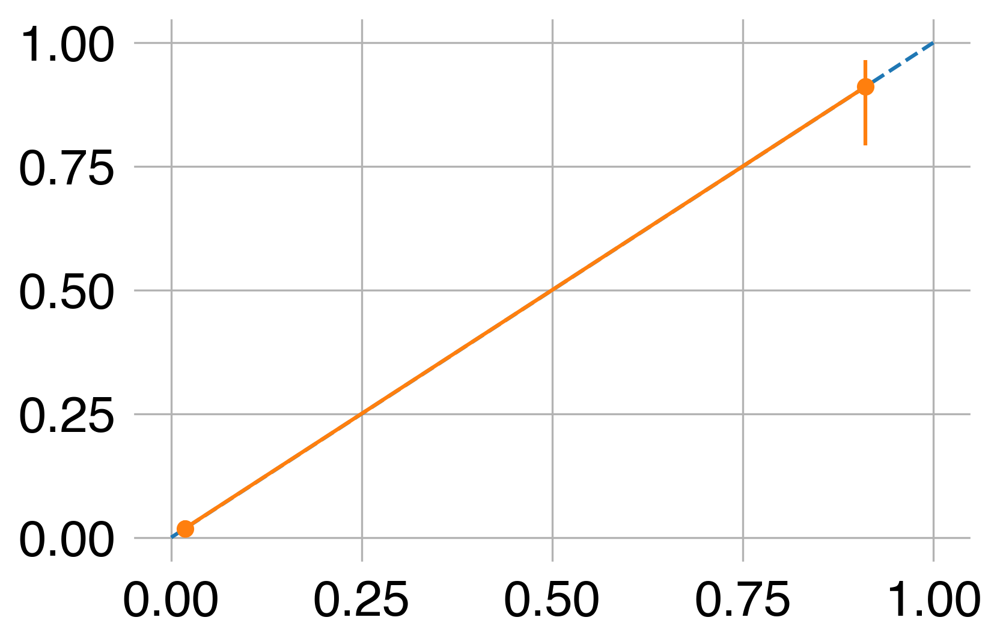

  category                 group      prop      mean        ll        ul  \
0        1  ballotpedia-campaign  0.012232  0.016286  0.007465  0.018793   
1        1                  orgs  0.030675  0.021453  0.017503  0.039115   
2        2  ballotpedia-campaign  0.866667  0.916133  0.163480  0.080237   
3        2                  orgs  1.000000  0.900754  0.203883  0.000000   

   count  
0  327.0  
1  163.0  
2   30.0  
3   15.0  
Brier score loss: 0.021727229795064414


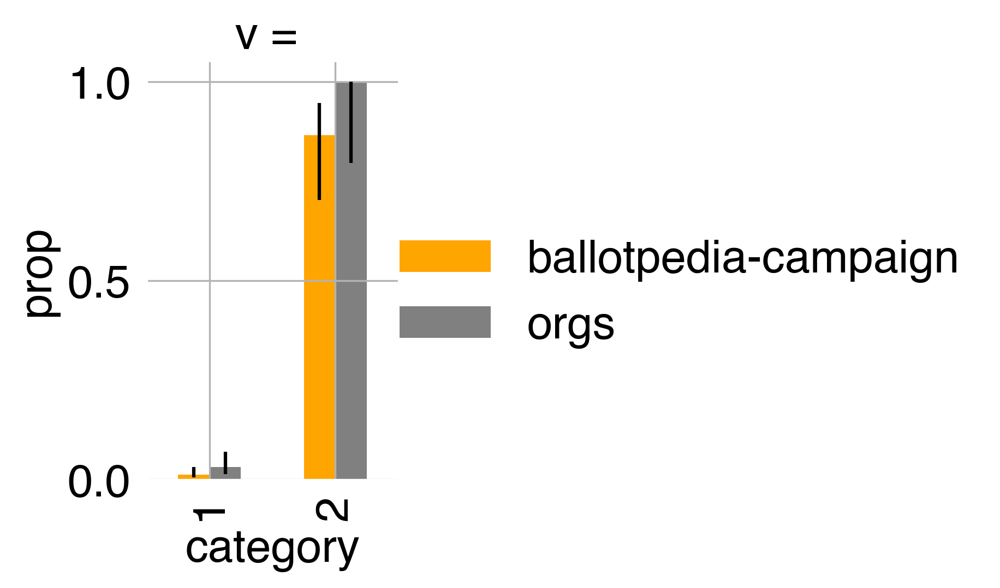

In [25]:
print_calibration_output(clf, xVal, yVal, groups=xVal['source'], bins=2)

  category      prop      mean        ll        ul  count
0        1  0.014006  0.017613  0.008009  0.018356  357.0
1        2  0.911765  0.924282  0.141370  0.057769   34.0


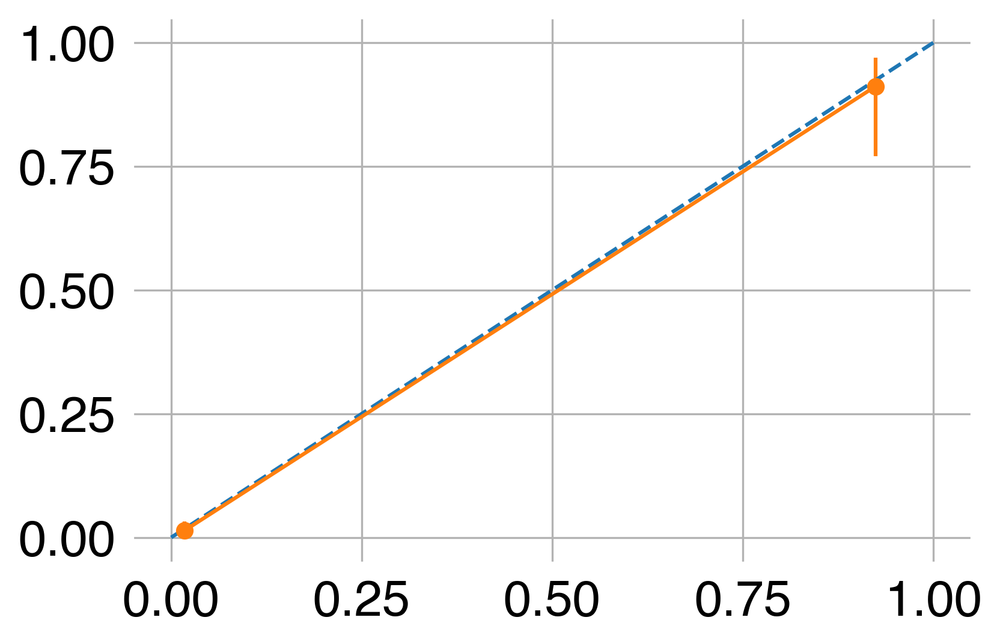

  category             group      prop      mean        ll        ul  count
0        1  Democratic Party  0.013289  0.016690  0.008109  0.020376  301.0
1        1  Republican Party  0.017857  0.022573  0.014698  0.076599   56.0
2        2  Democratic Party  0.896552  0.932569  0.160403  0.067633   29.0
3        2  Republican Party  1.000000  0.876217  0.434482  0.000000    5.0
Brier score loss: 0.019117294266712624


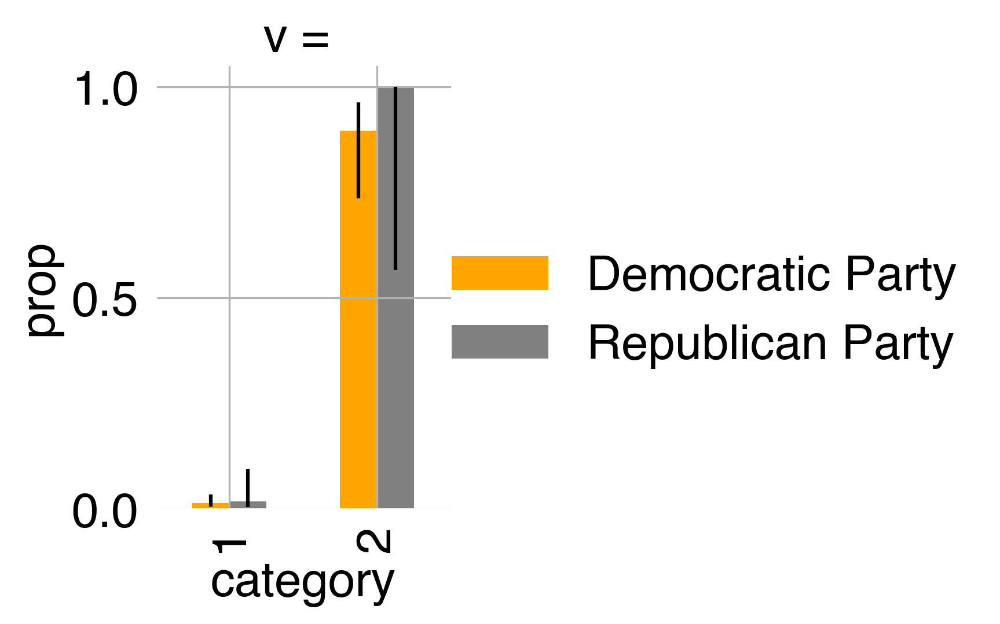

In [26]:
mask = (xVal['party_affiliation'] == 'Republican Party') | (xVal['party_affiliation'] == 'Democratic Party')

print_calibration_output(clf, xVal[mask], yVal[mask], groups=xVal.loc[mask, 'party_affiliation'], bins=2)

  category      prop      mean        ll        ul  count
0        1  0.012232  0.016286  0.007465  0.018793  327.0
1        2  0.866667  0.916133  0.163480  0.080237   30.0


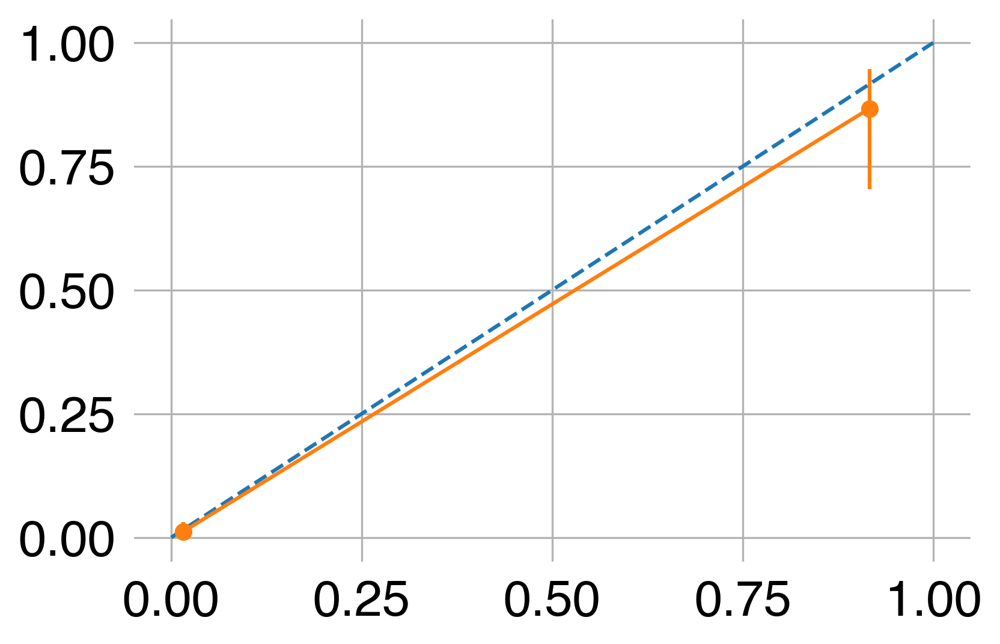

  category    group      prop      mean        ll        ul  count
0        1  Federal  0.010949  0.016998  0.007218  0.020742  274.0
1        1    State  0.018868  0.012608  0.015529  0.080561   53.0
2        2  Federal  0.880000  0.934453  0.179558  0.078332   25.0
3        2    State  0.800000  0.824535  0.424465  0.163776    5.0
Brier score loss: 0.020609441879368178


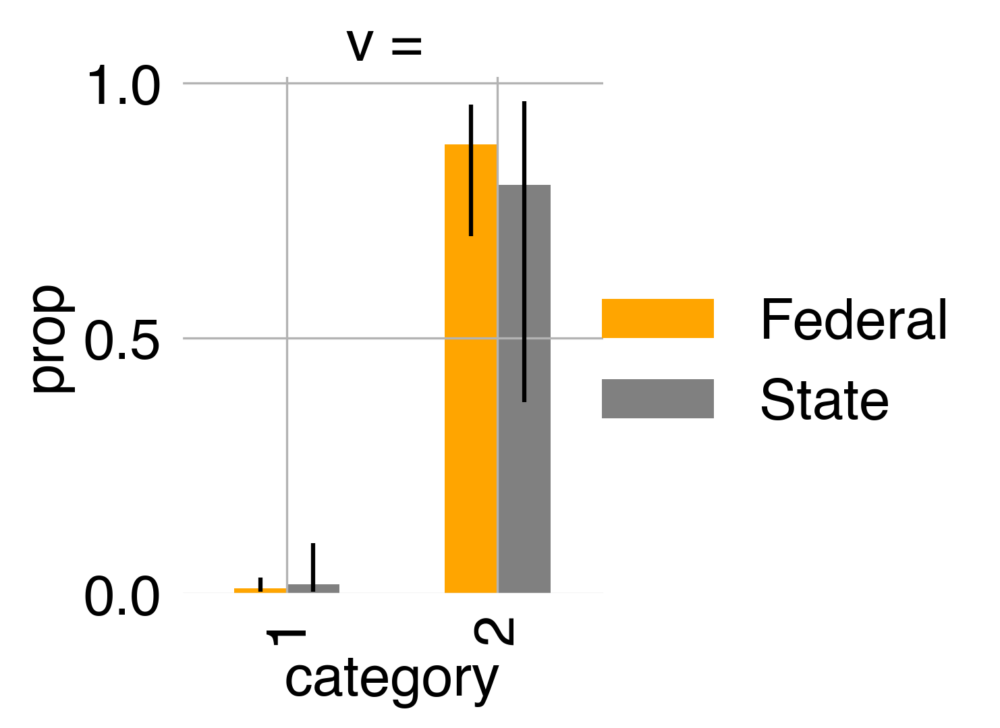

In [27]:
mask = (xVal['office_level'] == 'State') | (xVal['office_level'] == 'Federal')

print_calibration_output(clf, xVal[mask], yVal[mask], groups=xVal.loc[mask, 'office_level'], bins=2)

  category      prop      mean        ll        ul  count
0        1  0.009464  0.015780  0.006240  0.017987  317.0
1        2  0.862069  0.913241  0.167659  0.082957   29.0


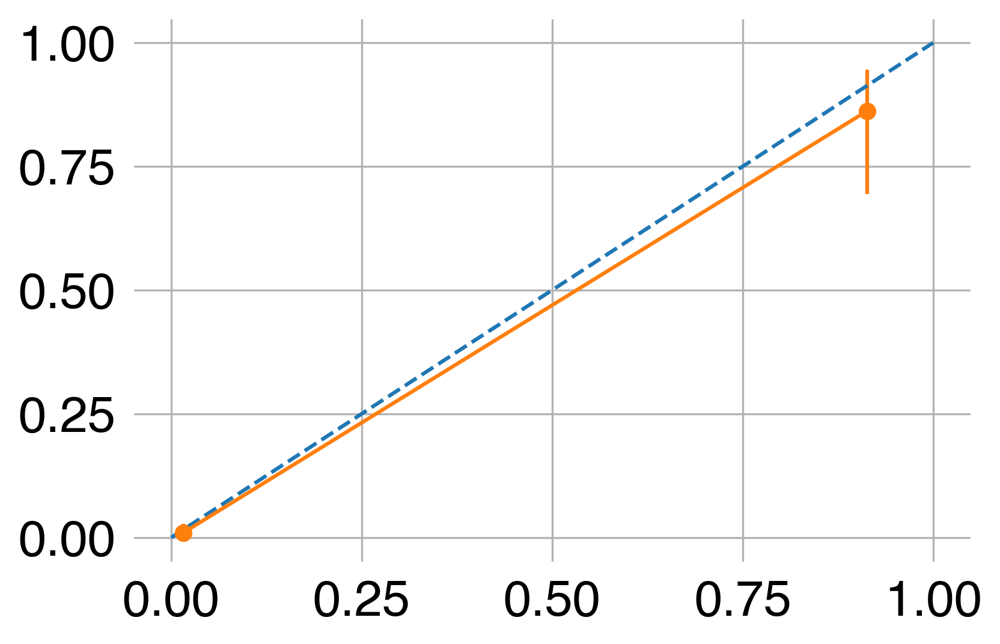

  category group      prop      mean        ll        ul  count
0        1    No  0.000000  0.013958  0.000000  0.016428  230.0
1        1   Yes  0.034483  0.020599  0.022687  0.062058   87.0
2        2    No  0.863636  0.918397  0.196986  0.088874   22.0
3        2   Yes  0.857143  0.897037  0.370271  0.117178    7.0
Brier score loss: 0.019543507833643763


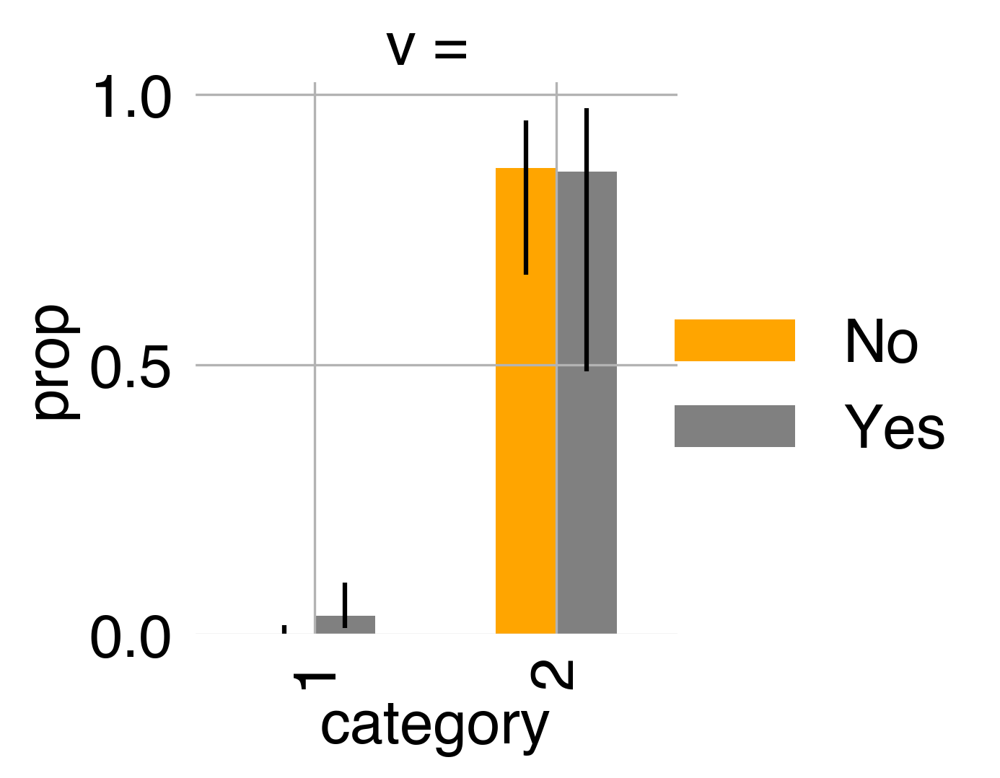

In [28]:
mask = (xVal['incumbent'] == 'Yes') | (xVal['incumbent'] == 'No')

print_calibration_output(clf, xVal[mask], yVal[mask], groups=xVal.loc[mask, 'incumbent'], bins=2)

## Score entire dataset

All the emails.

In [29]:
emails = pd.read_pickle('../data/emails_df.pkl')

In [30]:
res = clf.predict_proba(emails)[:,1]

In [31]:
pd.DataFrame({label_column + '_score': res}).to_pickle('../data/output/emails_' + label_column + '_score.pkl')

In [32]:
emails = None

All the A/B testing emails.

In [33]:
emails = pd.read_pickle('../data/emails_ab_df.pkl')

In [34]:
res = clf.predict_proba(emails)[:,1]

In [35]:
pd.DataFrame({label_column + '_score': res}).to_pickle('../data/output/emails_ab_' + label_column + '_score.pkl')

In [36]:
emails = None

In [37]:
res = None


[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.701 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.638 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier


[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.857 total time=   0.1s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__m


[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.553 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=10, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_


[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   0.2s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.615 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samp


[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.640 total time=   0.2s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.141 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifier__min_s


[CV 5/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=20, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   0.3s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=sqrt, classifier__min_samples_leaf=1, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=auto, classifier__min


[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.655 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=sqrt, classifier__min_samples_leaf=2, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=sqrt, classifier__m


[CV 1/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.541 total time=   0.1s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classif


[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=4, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 1/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.405 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=sqrt, classifier__min_sam


[CV 3/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.525 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=log2, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=log2, classifier__m


[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.622 total time=   0.1s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.650 total time=   0.1s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=100, classifier__max_features=log2, classifier__min_sampl


[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=70, classifier__max_features=auto, classifier__min_samples_leaf=8, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.1, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=8, classifier__min_samples_split=2, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.548 total time=   0.2s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=log2, classifier__min


[CV 5/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.675 total time=   0.2s
[CV 5/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=70, classifier__max_features=sqrt, classifier__min_samples_leaf=6, classifier__min_samples_split=15, classifier__n_estimators=50, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.444 total time=   0.2s
[CV 5/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__


[CV 3/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=100, classifier__max_features=auto, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=20, feature_pipeline__features__ngram_tags_org__features__max_df=1.0, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.866 total time=   0.1s
[CV 2/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=90, classifier__max_features=auto, classifier__min_samples_leaf=2, classifier__min_samples_split=20, classifier__n_estimators=70, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 2/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__mi


[CV 1/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=None, classifier__max_features=auto, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.02, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.648 total time=   0.2s
[CV 3/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=None, classifier__max_features=log2, classifier__min_samples_leaf=6, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.04, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.492 total time=   0.1s
[CV 4/5] END classifier__bootstrap=True, classifier__criterion=entropy, classifier__max_depth=10, classifier__max_features=auto, classifie


[CV 4/5] END classifier__bootstrap=False, classifier__criterion=entropy, classifier__max_depth=50, classifier__max_features=log2, classifier__min_samples_leaf=1, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__ngram_tags_org__features__max_df=0.01, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.871 total time=   0.3s
[CV 3/5] END classifier__bootstrap=False, classifier__criterion=gini, classifier__max_depth=30, classifier__max_features=auto, classifier__min_samples_leaf=1, classifier__min_samples_split=20, classifier__n_estimators=10, feature_pipeline__features__ngram_tags_org__features__max_df=0.005, feature_pipeline__features__ngram_tags_stopwords__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.448 total time=   0.1s
[CV 1/5] END classifier__bootstrap=True, classifier__criterion=gini, classifier__max_depth=50, classifier__max_features=log2, classifier__min_